<a href="https://colab.research.google.com/github/komazawa-deep-learning/komazawa-deep-learning.github.io/blob/master/2025notebooks/2025_1215qiita88_v_ppo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# [【強化学習】方策学習をもっとシンプルに！シンプルに方策を学習できるオフポリシー型PPOができた](https://qiita.com/pocokhc/items/0b87c473d450303021c8)
* source: https://colab.research.google.com/drive/1Xs86kwLp-Dla-S0ITwXr5Dpyk7OdHpeO?usp=sharing#scrollTo=5tWBgcSwOlXb

# 準備

In [ ]:
!pip install srl-framework==1.4.4
!pip install mlflow

In [ ]:
import srl
srl.__version__

# V-PPO

In [ ]:
import math
import random
from dataclasses import dataclass, field
from typing import List

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim

from srl.base.rl.algorithms.base_continuous import RLConfig, RLWorker
from srl.base.rl.memory import RLMemory
from srl.base.rl.parameter import RLParameter
from srl.base.rl.processor import RLProcessor
from srl.base.rl.registration import register
from srl.base.rl.trainer import RLTrainer
from srl.base.spaces.space import SpaceBase
from srl.rl.models.config.input_block import InputBlockConfig
from srl.rl.torch_.helper import model_backup, model_restore


def compute_normal_logprob_np(x, loc, scale):
    return -0.5 * math.log(2 * math.pi) - np.log(scale) - 0.5 * (((x - loc) / scale) ** 2)


def compute_normal_logprob_sgp_np(x, loc, scale, epsilon: float = 1e-10):
    logmu = compute_normal_logprob_np(x, loc, scale)
    x = 1.0 - np.tanh(x) ** 2  # dy/dx = 1 - tanh^2(x)
    x = np.clip(x, epsilon, 1.0)
    return logmu - np.sum(np.log(x), axis=-1, keepdims=True)


def compute_normal_logprob_torch(x, loc, log_scale):
    return -0.5 * math.log(2 * math.pi) - log_scale - 0.5 * (((x - loc) / torch.exp(log_scale)) ** 2)


def compute_normal_logprob_sgp_torch(x, loc, log_scale, epsilon: float = 1e-10):
    logmu = compute_normal_logprob_torch(x, loc, log_scale)
    x = 1.0 - torch.tanh(x) ** 2
    x = torch.clamp(x, epsilon, 1.0)
    return logmu - torch.sum(torch.log(x), dim=-1, keepdim=True)


@dataclass
class VPPOConfig(RLConfig):
    test_epsilon: float = 0.0
    epsilon: float = 0.1
    epsilon_normal_scale: float = 1.0

    memory_warmup_size: int = 1000
    memory_capacity: int = 100_000

    lr: float = 0.0002
    batch_size: int = 64
    discount: float = 0.9
    loss_align_coeff: float = 0.1
    max_grad_norm: float = 10.0

    clip_range: float = 0.2

    input_block: InputBlockConfig = field(default_factory=lambda: InputBlockConfig())
    base_units: int = 512

    def get_name(self) -> str:
        return "V-PPO"

    def get_framework(self) -> str:
        return "torch"

    def get_processors(self, prev_observation_space: SpaceBase) -> List[RLProcessor]:
        return self.input_block.get_processors(prev_observation_space)


register(
    VPPOConfig(),
    __name__ + ":VPPOMemory",
    __name__ + ":VPPOParameter",
    __name__ + ":VPPOTrainer",
    __name__ + ":VPPOWorker",
    check_duplicate=False,
)


class VPPOMemory(RLMemory[VPPOConfig]):
    def setup(self):
        self.buffer = []

        # 分散学習用の設定
        self.register_worker_func(self.add)
        self.register_trainer_recv_func(self.sample)

    def length(self) -> int:
        return len(self.buffer)

    def add(self, batch) -> None:
        if len(self.buffer) >= self.config.memory_capacity:
            del self.buffer[0]
        self.buffer.append(batch)

    def sample(self):
        if len(self.buffer) < self.config.memory_warmup_size:
            return None
        return random.sample(self.buffer, self.config.batch_size)


class ActorCriticNetwork(nn.Module):
    def __init__(self, config: VPPOConfig):
        super().__init__()

        # --- input
        self.in_block = config.input_block.create_torch_block(config)

        # --- hidden block
        self.hidden_block = nn.Sequential(
            nn.Linear(self.in_block.out_size, config.base_units),
            nn.SiLU(),
            nn.Linear(config.base_units, config.base_units),
            nn.SiLU(),
        )

        # --- value
        self.value_block = nn.Sequential(
            nn.Linear(config.base_units, config.base_units),
            nn.SiLU(),
            nn.Linear(config.base_units, 1),
        )

        # --- policy
        self.policy_block = nn.Sequential(
            nn.Linear(config.base_units, config.base_units),
            nn.SiLU(),
        )
        self.mean_layer = nn.Linear(config.base_units, config.action_space.size)
        self.log_std_layer = nn.Linear(config.base_units, config.action_space.size)

    def forward(self, x: torch.Tensor):
        x = self.in_block(x)
        x = self.hidden_block(x)

        # value
        v = self.value_block(x)

        # policy
        p = self.policy_block(x)
        mean = self.mean_layer(p)
        log_std = self.log_std_layer(p)

        # 学習安定用
        log_std = torch.clamp(log_std, np.log(1e-10), np.log(10))

        return v, mean, log_std


class VPPOParameter(RLParameter[VPPOConfig]):
    def setup(self):
        super().setup()
        self.device = torch.device(self.config.used_device_torch)
        self.net = ActorCriticNetwork(self.config).to(self.device)

    def call_restore(self, dat, from_serialized: bool = False, **kwargs) -> None:
        model_restore(self.net, dat, from_serialized)

    def call_backup(self, serialized: bool = False, **kwargs):
        return model_backup(self.net, serialized)

    def summary(self, **kwargs):
        print(self.net)


class VPPOTrainer(RLTrainer[VPPOConfig, VPPOParameter, VPPOMemory]):
    def on_setup(self) -> None:
        self.device = self.parameter.device

        self.opt = optim.Adam(self.parameter.net.parameters(), lr=self.config.lr)
        self.criterion1 = nn.HuberLoss()
        self.criterion2 = nn.MSELoss()

    def train(self) -> None:
        batches = self.memory.sample()
        if batches is None:
            return

        state, n_state, action, old_logpi, reward, not_terminated, total_reward = zip(*batches)
        state = torch.from_numpy(np.asarray(state, dtype=np.float32)).to(self.device)
        n_state = torch.from_numpy(np.asarray(n_state, dtype=np.float32)).to(self.device)
        action = torch.from_numpy(np.asarray(action, dtype=np.float32)).to(self.device)
        old_logpi = torch.from_numpy(np.asarray(old_logpi, dtype=np.float32)).to(self.device)
        reward = torch.from_numpy(np.array(reward, dtype=np.float32)).unsqueeze(-1).to(self.device)
        not_terminated = torch.from_numpy(np.array(not_terminated, dtype=np.float32)).unsqueeze(-1).to(self.device)
        total_reward = torch.from_numpy(np.array(total_reward, dtype=np.float32)).unsqueeze(-1).to(self.device)

        v, mean, log_std = self.parameter.net(state)
        with torch.no_grad():
            n_v, _, _ = self.parameter.net(n_state)

        new_logpi = compute_normal_logprob_sgp_torch(action, mean, log_std)
        ratio = torch.exp(new_logpi - old_logpi)

        # --- advantage
        q = reward + not_terminated * self.config.discount * n_v
        adv = (q - v).detach()

        # --- value loss
        ratio_detach = ratio.detach()
        loss_value = self.criterion1(ratio_detach * q, v)
        loss_v_align = self.criterion2(ratio_detach * total_reward, v)
        self.info["loss_value"] = loss_value.item()
        self.info["loss_v_align"] = loss_v_align.item()

        # --- cliepped policy loss
        ratio_clipped = torch.clamp(ratio, 1 - self.config.clip_range, 1 + self.config.clip_range)
        loss_policy = torch.minimum(ratio * adv, ratio_clipped * adv)
        loss_policy = -torch.mean(loss_policy)
        self.info["loss_policy"] = loss_policy.item()

        # bp
        loss = loss_policy + loss_value + self.config.loss_align_coeff * loss_v_align
        self.opt.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(self.parameter.net.parameters(), max_norm=self.config.max_grad_norm)
        self.opt.step()

        self.train_count += 1


class VPPOWorker(RLWorker[VPPOConfig, VPPOParameter, VPPOMemory]):
    def on_setup(self, worker, context):
        self.device = self.parameter.device

    def on_reset(self, worker) -> None:
        self.episode = []

    def policy(self, worker):
        state = torch.from_numpy(worker.state[np.newaxis, ...].astype(np.float32)).to(self.device)
        v, mean, log_std = self.parameter.net(state)
        loc = mean.detach().cpu().numpy()[0]
        scale = np.exp(log_std.detach().cpu().numpy()[0])

        epsilon = self.config.epsilon if self.training else self.config.test_epsilon
        if random.random() < epsilon:
            loc = 0
            scale = self.config.epsilon_normal_scale
            self.action = np.random.normal(loc, scale, size=self.config.action_space.size)
        else:
            if self.training:
                self.action = np.random.normal(loc, scale)
            else:
                self.action = loc

        # Squashed Gaussian policy
        self.log_prob = compute_normal_logprob_sgp_np(self.action, loc, scale)
        env_action = np.tanh(self.action)

        # 環境に合わせてアクションを変更
        # （Squashed Gaussian policyで -1～1になってる）
        env_action = (env_action + 1) / 2
        env_action = self.config.action_space.low + env_action * (self.config.action_space.high - self.config.action_space.low)
        return env_action

    def on_step(self, worker):
        if not self.training:
            return
        self.episode.append(
            [
                worker.state,
                worker.next_state,
                self.action,
                np.maximum(self.log_prob, math.log(1e-6)),  # 0除算回避用
                worker.reward,
                int(not worker.terminated),
            ]
        )
        if worker.done:
            # 割引報酬和を計算してbatchを追加する
            total_reward = 0
            for b in reversed(self.episode):
                total_reward = b[4] + self.config.discount * total_reward
                self.memory.add(b[:] + [total_reward])

    def render_terminal(self, worker, **kwargs):
        state = torch.from_numpy(worker.state[np.newaxis, ...].astype(np.float32)).to(self.device)
        v, mean, log_std = self.parameter.net(state)
        print(f"V: {v.detach().cpu().numpy()[0][0]:.7f}")
        for a in range(self.config.action_space.size):  # type: ignore
            s = f"[{a}] mean: {mean.detach().cpu().numpy()[0][a]:.7f}"
            s += f", stddev: {torch.exp(log_std).detach().cpu().numpy()[0][a]:.7f}"
            print(s)


## Pendulumの学習

In [ ]:
rl_config = VPPOConfig(
    lr=0.0005,
    batch_size=64,
    discount=0.9,
    base_units=64,
    clip_range=0.02,
)
env_config = srl.EnvConfig("Pendulum-v1")
runner = srl.Runner(env_config, rl_config)
runner.model_summary()



ActorCriticNetwork(
  (in_block): InputValueBlock(
    (hidden_layers): ModuleList(
      (0): Flatten(start_dim=1, end_dim=-1)
    )
  )
  (hidden_block): Sequential(
    (0): Linear(in_features=3, out_features=64, bias=True)
    (1): SiLU()
    (2): Linear(in_features=64, out_features=64, bias=True)
    (3): SiLU()
  )
  (value_block): Sequential(
    (0): Linear(in_features=64, out_features=64, bias=True)
    (1): SiLU()
    (2): Linear(in_features=64, out_features=1, bias=True)
  )
  (policy_block): Sequential(
    (0): Linear(in_features=64, out_features=64, bias=True)
    (1): SiLU()
  )
  (mean_layer): Linear(in_features=64, out_features=1, bias=True)
  (log_std_layer): Linear(in_features=64, out_features=1, bias=True)
)


In [ ]:
runner.set_history_on_memory(interval=200, interval_mode="step", enable_eval=True)
runner.train(max_train_count=200*200)
print(runner.evaluate())


### rl: V-PPO, torch=cpu, train, env: Pendulum-v1, max train: 40000
23:54:38  1.00s(     - left)  583st/s 0.00tr/s   400mem     0tr [CPU 49%,M13%]     2ep    584st 200st/ep -1316.7 -1252.6 -1188.5 re
23:54:43  6.01s(  6.8m left)  180st/s   97tr/s  1400mem   488tr [CPU 48%,M14%]     7ep   1487st 200st/ep -1624.0 -1378.9 -801.9 re|loss_value 1.801|loss_v_align 95.9|loss_policy 0.206
23:54:48 11.01s(  5.2m left)  124st/s  124tr/s  2000mem  1111tr [CPU 49%,M14%]    10ep   2110st 200st/ep -1001.4 -959.7 -911.2 re|loss_value 2.201|loss_v_align 91.7|loss_policy 0.498
23:54:55 18.52s(  7.0m left)   91st/s   91tr/s  2600mem  1797tr [CPU 45%,M13%]    13ep   2796st 200st/ep -1501.3 -1303.0 -944.9 re|loss_value 7.981|loss_v_align 381.6|loss_policy 0.207
23:55:07 29.77s(  5.3m left)  116st/s  116tr/s  4000mem  3112tr [CPU 50%,M13%]    20ep   4111st 200st/ep -1426.0 -1131.7 -820.6 re|loss_value 5.173|loss_v_align 132.8|loss_policy 0.450
23:55:23 46.66s(  4.5m left)  128st/s  128tr/s  6200mem  5289tr

In [ ]:
df = runner.get_history().get_df()
print(df.columns)

df.plot("step", "eval_reward0")

AssertionError: 

In [ ]:
runner.animation_save_gif("vppo.gif")
runner.animation_display()


### rl: V-PPO, torch=cpu, run_render, env: Pendulum-v1, max episodes: 1
11:54:21  1.03s(     - left)   16st/s 40800mem [CPU 45%,M25%]     0ep     17st  17st/ep     (ongoing) -131.1 re
11:54:26  6.07s(     - left)   17st/s 40800mem [CPU 50%,M25%]     0ep    107st 107st/ep     (ongoing) -292.9 re
11:54:32 11.80s( 0.00s left)   16st/s 40800mem [CPU 49%,M25%]     1ep    200st 200st/ep -292.9 -292.9 -292.9 re
### rl: V-PPO, torch=cpu, run_render, env: Pendulum-v1, max episodes: 1
11:54:43  1.01s(     - left)   18st/s 40800mem [CPU 50%,M30%]     0ep     19st  19st/ep     (ongoing)  -59.5 re
11:54:48  6.05s(     - left)   17st/s 40800mem [CPU 49%,M30%]     0ep    106st 106st/ep     (ongoing) -128.7 re
11:54:54 12.27s( 0.00s left)   15st/s 40800mem [CPU 47%,M30%]     1ep    200st 200st/ep -128.7 -128.7 -128.7 re


Rendering(mode='rgb_array', kwargs={}, step_stop=False, render_interval=33.333333333333336, render_skip_step=True, render_env=True, render_worker=0, render_add_rl_terminal=True, render_add_rl_rgb=True, render_add_info_text=True)

# NoTarget SAC

In [ ]:
from dataclasses import dataclass, field
from typing import List

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim

from srl.base.rl.algorithms.base_continuous import RLConfig, RLWorker
from srl.base.rl.parameter import RLParameter
from srl.base.rl.processor import RLProcessor
from srl.base.rl.registration import register
from srl.base.rl.trainer import RLTrainer
from srl.base.spaces.space import SpaceBase
from srl.rl.memories.replay_buffer import ReplayBufferConfig, RLReplayBuffer
from srl.rl.models.config.input_block import InputBlockConfig
from srl.rl.torch_.helper import model_backup, model_restore


@dataclass
class NoTSACConfig(RLConfig):
    policy_training_scale: float = 0.5

    memory: ReplayBufferConfig = field(default_factory=lambda: ReplayBufferConfig())

    lr: float = 0.0002
    batch_size: int = 64
    discount: float = 0.9
    loss_align_coeff: float = 0.1
    max_grad_norm: float = 10.0

    input_block: InputBlockConfig = field(default_factory=lambda: InputBlockConfig())
    base_units: int = 512
    act_emb_units: int = 512

    def get_name(self) -> str:
        return "NoT-SAC"

    def get_framework(self) -> str:
        return "torch"

    def get_processors(self, prev_observation_space: SpaceBase) -> List[RLProcessor]:
        return self.input_block.get_processors(prev_observation_space)


register(
    NoTSACConfig(),
    __name__ + ":NoTSACMemory",
    __name__ + ":NoTSACParameter",
    __name__ + ":NoTSACTrainer",
    __name__ + ":NoTSACWorker",
    check_duplicate=False,
)


class NoTSACMemory(RLReplayBuffer):
    pass


class PolicyNetwork(nn.Module):
    def __init__(self, config: NoTSACConfig):
        super().__init__()

        self.in_block = config.input_block.create_torch_block(config)

        self.policy_block = nn.Sequential(
            nn.Linear(self.in_block.out_size, config.base_units),
            nn.SiLU(),
            nn.Linear(config.base_units, config.base_units),
            nn.SiLU(),
        )
        self.mean_layer = nn.Linear(config.base_units, config.action_space.size)
        self.log_std_layer = nn.Linear(config.base_units, config.action_space.size)

    def forward(self, x: torch.Tensor):
        x = self.in_block(x)
        p = self.policy_block(x)
        mean = self.mean_layer(p)
        log_std = self.log_std_layer(p)

        # 学習安定用
        log_std = torch.clamp(log_std, np.log(1e-10), np.log(10))

        return mean, log_std


class QNetwork(nn.Module):
    def __init__(self, config: NoTSACConfig):
        super().__init__()

        self.in_block = config.input_block.create_torch_block(config)
        self.act_block = nn.Sequential(
            nn.Linear(config.action_space.size, config.act_emb_units),
            nn.SiLU(),
        )

        self.q_block = nn.Sequential(
            nn.Linear(self.in_block.out_size + config.act_emb_units, config.base_units),
            nn.SiLU(),
            nn.Linear(config.base_units, config.base_units),
            nn.SiLU(),
            nn.Linear(config.base_units, 1),
        )

    def forward(self, x: torch.Tensor, action: torch.Tensor):
        x = self.in_block(x)
        a = self.act_block(action)
        x = torch.cat([x, a], dim=-1)
        x = self.q_block(x)
        return x


class NoTSACParameter(RLParameter[NoTSACConfig]):
    def setup(self):
        self.device = torch.device(self.config.used_device_torch)
        self.policy = PolicyNetwork(self.config).to(self.device)
        self.qnet = QNetwork(self.config).to(self.device)

    def call_restore(self, dat, from_serialized: bool = False, **kwargs) -> None:
        model_restore(self.policy, dat[0], from_serialized)
        model_restore(self.qnet, dat[1], from_serialized)

    def call_backup(self, serialized: bool = False, **kwargs):
        return [
            model_backup(self.policy, serialized),
            model_backup(self.qnet, serialized),
        ]

    def summary(self, **kwargs):
        print(self.policy)
        print(self.qnet)


class NoTSACTrainer(RLTrainer[NoTSACConfig, NoTSACParameter, NoTSACMemory]):
    def on_setup(self) -> None:
        self.device = self.parameter.device

        self.opt_policy = optim.Adam(self.parameter.policy.parameters(), lr=self.config.lr)
        self.opt_q = optim.Adam(self.parameter.qnet.parameters(), lr=self.config.lr)
        self.criterion1 = nn.HuberLoss()
        self.criterion2 = nn.MSELoss()

    def train(self) -> None:
        batches = self.memory.sample()
        if batches is None:
            return

        state, n_state, action, reward, not_terminated, total_reward = zip(*batches)
        state = torch.from_numpy(np.asarray(state, dtype=np.float32)).to(self.device)
        n_state = torch.from_numpy(np.asarray(n_state, dtype=np.float32)).to(self.device)
        action = torch.from_numpy(np.asarray(action, dtype=np.float32)).to(self.device)
        reward = torch.from_numpy(np.array(reward, dtype=np.float32)).unsqueeze(-1).to(self.device)
        not_terminated = torch.from_numpy(np.array(not_terminated, dtype=np.float32)).unsqueeze(-1).to(self.device)
        total_reward = torch.from_numpy(np.array(total_reward, dtype=np.float32)).unsqueeze(-1).to(self.device)

        with torch.no_grad():
            n_mean, n_log_std = self.parameter.policy(n_state)
            n_action = torch.normal(n_mean, torch.exp(n_log_std))
            # Squashed Gaussian policy
            n_action = torch.tanh(n_action)
            n_q = self.parameter.qnet(n_state, n_action)
            target_q = reward + not_terminated * self.config.discount * n_q

        # --- q loss
        q = self.parameter.qnet(state, action)
        loss_q = self.criterion1(target_q, q)
        loss_q_align = self.criterion2(total_reward, q)

        loss = loss_q + self.config.loss_align_coeff * loss_q_align
        self.info["loss_q"] = loss_q.item()
        self.info["loss_q_align"] = loss_q_align.item()

        self.opt_q.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(self.parameter.qnet.parameters(), max_norm=self.config.max_grad_norm)
        self.opt_q.step()

        # --- policy loss
        mean, log_std = self.parameter.policy(state)
        # ReparameterizationTrick
        e = torch.normal(torch.zeros_like(mean), torch.ones_like(mean))
        action = mean + torch.exp(log_std) * e
        # Squashed Gaussian policy
        action = torch.tanh(action)

        q = self.parameter.qnet(state, action)
        loss_policy = -q.mean()
        self.info["loss_policy"] = loss_policy.item()

        self.opt_policy.zero_grad()
        loss_policy.backward()
        torch.nn.utils.clip_grad_norm_(self.parameter.policy.parameters(), max_norm=self.config.max_grad_norm)
        self.opt_policy.step()

        self.train_count += 1


class NoTSACWorker(RLWorker[NoTSACConfig, NoTSACParameter, NoTSACMemory]):
    def on_setup(self, worker, context):
        self.device = self.parameter.device

    def on_reset(self, worker) -> None:
        self.episode = []

    def policy(self, worker):
        state = torch.from_numpy(worker.state[np.newaxis, ...].astype(np.float32)).to(self.device)
        mean, log_std = self.parameter.policy(state)
        mean = mean.detach().cpu().numpy()[0]

        if self.training:
            # 分散は固定でランダムにアクションを決める
            scale = self.config.policy_training_scale
            self.action = np.random.normal(mean, scale, size=self.config.action_space.size)
        else:
            # 評価中は平均を使う
            self.action = mean

        # Squashed Gaussian policy
        self.action = np.tanh(self.action)

        # 環境に合わせてアクションを変更
        # （Squashed Gaussian policyで -1～1になってる）
        env_action = (self.action + 1) / 2
        env_action = self.config.action_space.low + env_action * (self.config.action_space.high - self.config.action_space.low)
        return env_action

    def on_step(self, worker):
        if not self.training:
            return
        self.episode.append(
            [
                worker.state,
                worker.next_state,
                self.action,
                worker.reward,
                int(not worker.terminated),
            ]
        )
        if worker.done:
            # 割引報酬和を計算してbatchを追加する
            total_reward = 0
            for b in reversed(self.episode):
                total_reward = b[3] + self.config.discount * total_reward
                self.memory.add(b[:] + [total_reward])

    def render_terminal(self, worker, **kwargs):
        state = torch.from_numpy(worker.state[np.newaxis, ...].astype(np.float32)).to(self.device)
        mean, log_std = self.parameter.policy(state)
        q = self.parameter.qnet(state, mean)
        print(f"Q: {q.detach().cpu().numpy()[0][0]:.7f}")
        for a in range(self.config.action_space.size):  # type: ignore
            s = f"[{a}] mean: {mean.detach().cpu().numpy()[0][a]:.7f}"
            s += f", stddev: {torch.exp(log_std).detach().cpu().numpy()[0][a]:.7f}"
            print(s)


## Pendulumの学習

In [ ]:
rl_config = NoTSACConfig(
    lr=0.0005,
    batch_size=64,
    discount=0.9,
    base_units=64,
    act_emb_units=64,
)
env_config = srl.EnvConfig("Pendulum-v1")
runner = srl.Runner(env_config, rl_config)
runner.model_summary()



PolicyNetwork(
  (in_block): InputValueBlock(
    (hidden_layers): ModuleList(
      (0): Flatten(start_dim=1, end_dim=-1)
    )
  )
  (policy_block): Sequential(
    (0): Linear(in_features=3, out_features=64, bias=True)
    (1): SiLU()
    (2): Linear(in_features=64, out_features=64, bias=True)
    (3): SiLU()
  )
  (mean_layer): Linear(in_features=64, out_features=1, bias=True)
  (log_std_layer): Linear(in_features=64, out_features=1, bias=True)
)
QNetwork(
  (in_block): InputValueBlock(
    (hidden_layers): ModuleList(
      (0): Flatten(start_dim=1, end_dim=-1)
    )
  )
  (act_block): Sequential(
    (0): Linear(in_features=1, out_features=64, bias=True)
    (1): SiLU()
  )
  (q_block): Sequential(
    (0): Linear(in_features=67, out_features=64, bias=True)
    (1): SiLU()
    (2): Linear(in_features=64, out_features=64, bias=True)
    (3): SiLU()
    (4): Linear(in_features=64, out_features=1, bias=True)
  )
)


In [ ]:
runner.set_history_on_memory(interval=200, interval_mode="step", enable_eval=True)
runner.train(max_train_count=200*200)
print(runner.evaluate())


### rl: NoT-SAC, torch=cpu, train, env: Pendulum-v1, max train: 40000
11:32:27  1.00s(     - left)  774st/s 0.00tr/s   600mem     0tr [CPU 47%,M24%]     3ep    775st 200st/ep -1626.4 -1214.2 -946.6 re
11:32:33  6.00s(  7.9m left)  128st/s   83tr/s  1400mem   418tr [CPU 50%,M25%]     7ep   1417st 200st/ep -1470.3 -1214.2 -969.1 re|loss_q 1.418|loss_q_align 302.1|loss_policy 57.1
11:32:38 11.09s(  5.7m left)  114st/s  114tr/s  2000mem  1002tr [CPU 51%,M25%]    10ep   2001st 200st/ep -1661.8 -1620.0 -1587.1 re|loss_q 3.459|loss_q_align 99.8|loss_policy 54.9
11:32:45 18.61s(  5.5m left)  114st/s  114tr/s  2800mem  1864tr [CPU 48%,M25%]    14ep   2863st 200st/ep -1775.5 -1670.9 -1533.4 re|loss_q 4.009|loss_q_align 137.4|loss_policy 61.3
11:32:56 29.87s(  6.0m left)  103st/s  103tr/s  4000mem  3028tr [CPU 48%,M25%]    20ep   4027st 200st/ep -1463.8 -1192.7 -1034.5 re|loss_q 2.675|loss_q_align 69.5|loss_policy 62.2
11:33:13 46.75s(  5.0m left)  116st/s  116tr/s  5800mem  4994tr [CPU 50%,M25%]

Index(['name', 'time', 'step', 'episode', 'episode_time', 'episode_step',
       'sync', 'train', 'memory', 'system_memory', 'cpu', 'eval_reward0',
       'reward0', 'trainer_loss_q', 'trainer_loss_q_align',
       'trainer_loss_policy'],
      dtype='object')


<Axes: xlabel='step'>

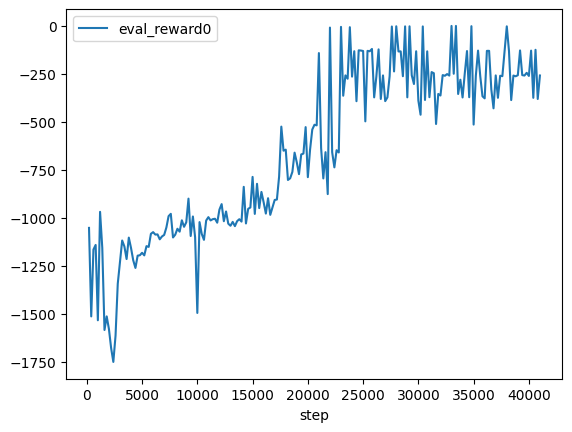

In [ ]:
df = runner.get_history().get_df()
print(df.columns)

df.plot("step", "eval_reward0")

In [ ]:
runner.animation_save_gif("not_sac.gif")
runner.animation_display()

### rl: NoT-SAC, torch=cpu, run_render, env: Pendulum-v1, max episodes: 1
11:38:16  1.02s(     - left)   15st/s 40800mem [CPU 45%,M24%]     0ep     16st  16st/ep     (ongoing) -112.1 re
11:38:21  6.03s(     - left)   17st/s 40800mem [CPU 50%,M24%]     0ep    105st 105st/ep     (ongoing) -235.9 re
11:38:27 11.96s( 0.00s left)   16st/s 40800mem [CPU 49%,M24%]     1ep    200st 200st/ep -236.2 -236.2 -236.2 re
### rl: NoT-SAC, torch=cpu, run_render, env: Pendulum-v1, max episodes: 1
11:38:39  1.05s(     - left)   18st/s 40800mem [CPU 50%,M24%]     0ep     19st  19st/ep     (ongoing) -104.5 re
11:38:44  6.10s(     - left)   14st/s 40800mem [CPU 45%,M24%]     0ep     94st  94st/ep     (ongoing) -128.7 re
11:38:50 12.52s( 0.00s left)   16st/s 40800mem [CPU 49%,M24%]     1ep    200st 200st/ep -129.0 -129.0 -129.0 re


Rendering(mode='rgb_array', kwargs={}, step_stop=False, render_interval=33.333333333333336, render_skip_step=True, render_env=True, render_worker=0, render_add_rl_terminal=True, render_add_rl_rgb=True, render_add_info_text=True)